# Supernovae Classification Article

#### Content:

1. Modules Import
2. Utility Functions
3. Data Import
4. Dataset Review
5. Sampling (RMS & P-value cuts)
6. Preprocessing
    - Normalization
    - Shifting
    - Binarization
    - Linear Interpolation
7. Feature Generation
8. Cross-Validation Method (K-Fold)
9. Models
    - Baseline: Logistic Regression
    - Random Forest
    - Models for a comparison: XGBoost, CatBoost, One-Layer NN
10. Model Evaluation (Random Forest)
    - Table of Scores
    - ROC-Curve
    - Probability Distribution Histogram
    - Features Importance
    - Confusion Matrix Analysis

## Modules Import

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import math
import seaborn as sns

import sys

from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import roc_curve, roc_auc_score, accuracy_score, make_scorer, f1_score, recall_score, precision_score
from sklearn.model_selection import cross_val_score, StratifiedKFold, cross_val_predict, train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import cross_val_score

import copy
from sklearn.model_selection import StratifiedKFold

from sklearn.cluster import KMeans, DBSCAN
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from sklearn.calibration import CalibratedClassifierCV
from sklearn.model_selection import train_test_split

from IPython.display import clear_output
from sklearn.metrics import silhouette_score, silhouette_samples
from matplotlib import cm

from utils import binarization, interpolation, rolling_diff, rolling_ratio, log10_, KFoldsClassifier

from scipy import stats

from IPython.display import Markdown, display

def printmd(string):
    display(Markdown(string))

## Data Import

In [2]:
def type_mapping(claimedtype):
    return new_types.get(str(claimedtype).split(';')[0], 0)

def get_pval(row):
    pval = 1.0 - stats.chi2.cdf(row.rms_for_pval, row.size_r - 1)
    return pval

new_types = pd.read_csv('../data/types.csv')
new_types = dict(new_types.values)

data = pd.read_pickle('../data/new_article_data_r.pkl')
data['is_ia'] = data['type'].map(type_mapping)   
data['pval'] = data.apply(get_pval, axis=1)

In [3]:
data.shape

(5508, 9)

In [4]:
data = data[~data.type.isna()].reset_index(drop=True)

In [5]:
data.shape

(3979, 9)

In [6]:
data[(data.spec_class == 1) & (data.is_ia == 1)].shape

(478, 9)

In [7]:
data.head()

,sn_name,type,size_r,curve_r,spec_class,rms,rms_for_pval,is_ia,pval
0,ASASSN-13ax,Dwarf Nova,122,"[[56477.4482, nan, 1.8373842952834476e-06, 7.4...",0,9186.448800,1.111560e+06,0,0.000000e+00
1,ASASSN-13cu,Ia,4,"[[56531.4793028785, nan, 1.9052852266272632e-0...",0,2674.142946,8.022429e+03,1,0.000000e+00
2,ASASSN-13dd,Ia,3,"[[56564.6063, nan, 1.982257181831107e-06, 1.46...",0,22.321894,4.464379e+01,1,2.021737e-10
3,ASASSN-13dl,Ia,28,"[[56577.0974, nan, 2.5262713683571743e-07, 6.7...",0,-1.000000,-1.000000e+00,1,1.000000e+00
4,ASASSN-14ae,TDE,45,"[[56684.1203, nan, 3.8508801287880484e-07, 8.2...",1,433.613743,1.907900e+04,0,0.000000e+00


In [8]:
from collections import Counter

c = Counter()

for elem in data.type:
    try:
        name = elem.split(';')[0]
        c[name] += 1
    except:
        continue

In [9]:
pd.DataFrame(c, index=np.arange(len(c))).head(1).T.to_excel('filtered_sn_types.xlsx')

## Dataset Review

**Number of Samples**

In [10]:
data.shape[0]

3979

**Classes Distribution (0 - NOT_Ia, 1 - Ia)**

In [11]:
not_ia_share = data[data.is_ia == 0].shape[0] / data.shape[0]
ia_share = data[data.is_ia == 1].shape[0] / data.shape[0]

print("Not-Ia: {0:.2%}\nIa: {1:.2%}".format(not_ia_share, ia_share))

Not-Ia: 40.09%
Ia: 59.91%


## Sampling (RMS & P-value)

#### Visualisation Functions

In [12]:
def plot_log_hist(ax, df_col, xlim, bins, title):
    x = df_col
    ax.hist(x, bins=bins)
    ax.set_xlabel('p-value', fontsize=14)
    ax.set_ylabel('Count', fontsize=14)
    ax.set_xscale('log')
    ax.set_yscale('log')
    ax.set_xlim(xlim)
    ax.grid(b=1)
    ax.title.set_text(title)
    ax.title.set_fontsize(16)
    
def plot_hist(ax, df_col, bins, xlim, title):
    x = df_col
    ax.hist(x, bins=bins)
    ax.set_xlabel('Number of observations', fontsize=14)
    ax.set_ylabel('Count', fontsize=14)
    ax.set_xlim(xlim)
    ax.grid(b=1)
    ax.set_yscale('log')
    ax.title.set_text(title)
    ax.title.set_fontsize(16)
    
def plot_2d_hist(fig, ax, col1, col2):
    x = col1.values
    y = col2.values
    x_bins = np.logspace(-2, 3, 20)
    y_bins = np.linspace(0, 30, 30)
    H, xedges, yedges = np.histogram2d(x, y, bins=[x_bins, y_bins])
    pc = ax.pcolormesh(xedges, yedges, H.T, cmap=cm.Blues, alpha=0.8)
    ax.set_xscale('log')
    ax.set_xlabel('RMS')
    ax.set_ylabel('Number of Points')
    ax.title.set_text('RMS & Number of Points Distribution')
    fig.colorbar(pc)
    
def plot_cum_hist(ax, df_col):
    x = np.log(df_col)
    mu = np.mean(x)
    sigma = np.std(x)
    n_bins = 50
    n, bins, patches = ax.hist(x, n_bins, density=True, histtype='step',
                               cumulative=True, label='Empirical')
    y = ((1 / (np.sqrt(2 * np.pi) * sigma)) *
         np.exp(-0.5 * (1 / sigma * (bins - mu))**2))
    y = y.cumsum()
    y /= y[-1]
    ax.plot(bins, y, 'k--', linewidth=1.5, label='Theoretical')
    ax.hist(x, bins=bins, density=True, histtype='step', cumulative=-1,
            label='Reversed emp.')
    ax.grid(True)
    ax.legend(loc='best')
    ax.set_title('Cumulative step histograms')
    ax.set_xlabel('RMS (log)')
    ax.set_ylabel('Likelihood of occurrence')

#### RMS & P-values Distributions

/Users/mihailh/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.
  


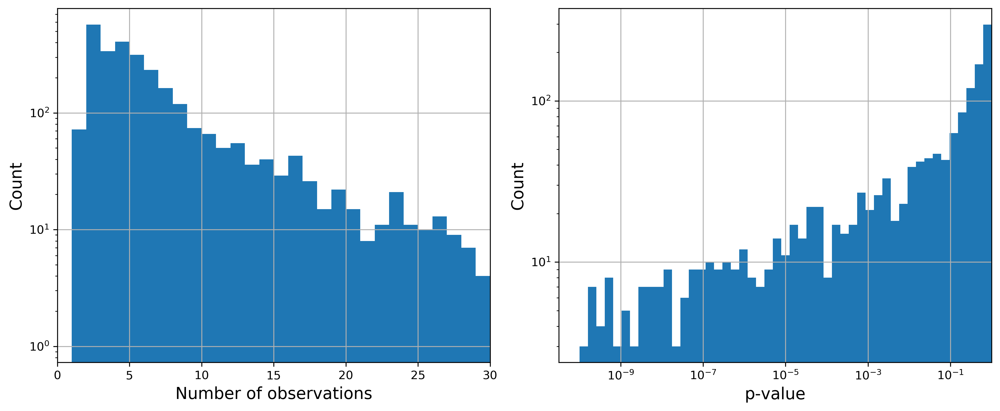

In [13]:
fig, ax = plt.subplots(1, 2, figsize=(12, 5), dpi=300)
plot_hist(ax[0], data[data.rms > 0].size_r, 
          bins=np.linspace(0, 60, 61), xlim=(0, 30), title='')
plot_log_hist(ax[1], data[data.rms > 0].pval, xlim=(0, 1), 
              bins=np.logspace(-10, 0, 50), title='')

plt.tight_layout()
plt.savefig(fname='images/pval_dists.pdf', format='pdf')

#### 2d Distribution for RMS and Number of Points

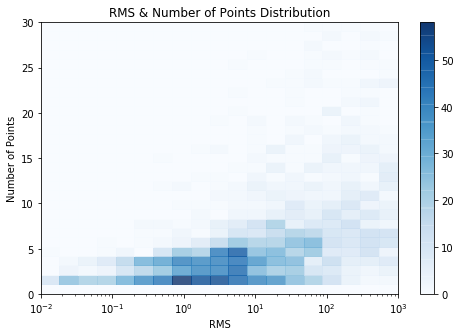

In [14]:
fig, ax = plt.subplots(figsize=(8, 5))
plot_2d_hist(fig, ax, data[data.rms > 0].rms, data[data.rms > 0].size_r)

### P-Value CUTS

In [15]:
choices = np.zeros(shape=(10, 9))

for size_r in range(10):
    for i, pval in enumerate([0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.9, 1]):
        n_samples = data[(data.pval <= pval) & (data.size_r >= size_r)].shape[0]
        choices[size_r, i] = n_samples

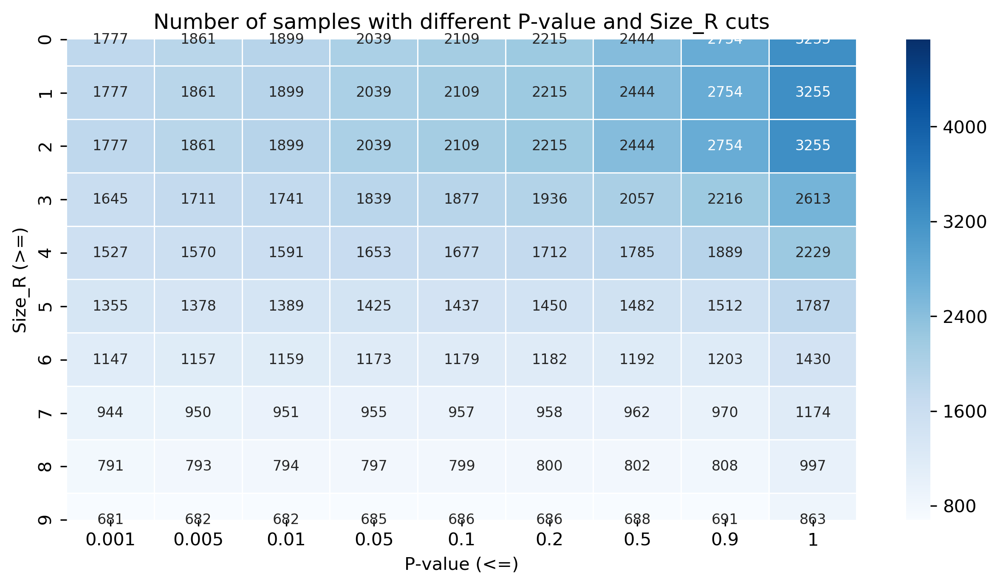

In [16]:
import seaborn as sns

fig, ax = plt.subplots(figsize=(10, 5), dpi=300)
sns.heatmap(choices, ax=ax, annot=True, fmt='.0f', linewidth=.5, cmap="Blues", 
            annot_kws={"size": 8}, vmax=4737,
            xticklabels=[0.001, 0.005, 0.01, 0.05, 0.1, 0.2, 0.5, 0.9, 1],
            yticklabels=np.arange(10))
ax.set_title('Number of samples with different P-value and Size_R cuts')
ax.set_xlabel('P-value (<=)')
ax.set_ylabel('Size_R (>=)')
plt.show()

## Preprocessing (4 Steps)

#### Normalization (Step 1)

In [17]:
def normalization(row):
    y = row.curve_r.y / row.curve_r.y.max()
    return y

data['y_normed'] = data.apply(normalization, axis=1)

#### Shifting (Step 2)

In [18]:
def shifting(row):
    x = row.curve_r.x - row.curve_r.x[row.y_normed.argmax()]
    return x

data['x_shifted'] = data.apply(shifting, axis=1)

#### Binarization (Step 3)

In [19]:
def get_bins(row):
    return binarization(row.x_shifted, row.y_normed, n=16, x_ranges=[-50, 100])

data['binarized'] = data.apply(get_bins, axis=1)

#### Linear Interpolation (Step 4)

In [20]:
def interpolate(row):
    return interpolation(np.arange(len(row.binarized)), row.binarized)

data['interpolated'] = data.apply(interpolate, axis=1)

In [21]:
bad_n_data = data[data.size_r < 4].reset_index(drop=True).copy()
bad_pval_data = data[data.pval >= 0.001].reset_index(drop=True).copy()
good_n_data = data[data.size_r >= 4].reset_index(drop=True).copy()
good_pval_data = data[data.pval < 0.001].reset_index(drop=True).copy()

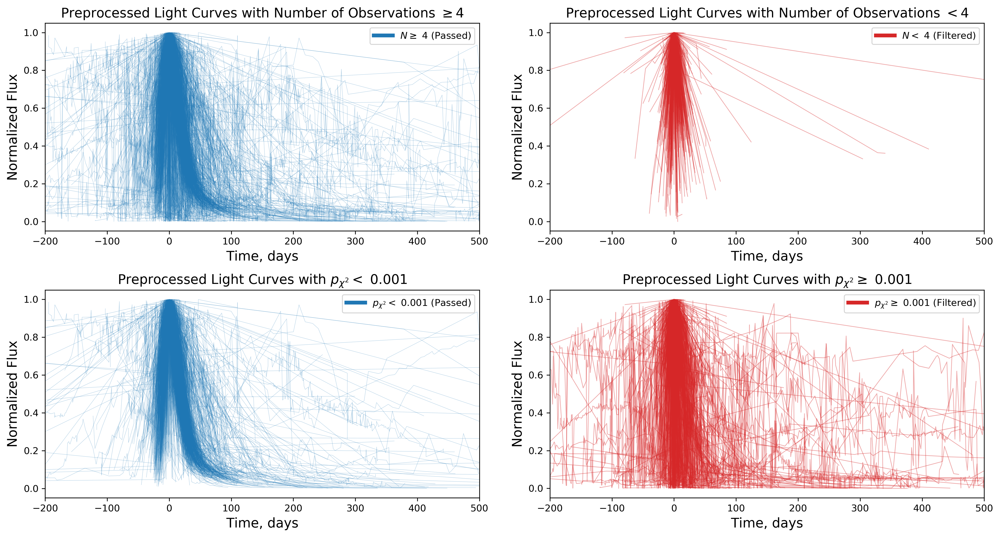

In [22]:
from matplotlib.lines import Line2D

good_line = [Line2D([0], [0], color='C0', lw=4)]
bad_line = [Line2D([0], [0], color='C3', lw=4)]

fig, ax = plt.subplots(2, 2, figsize=(15, 8), dpi=300)

for i in range(good_n_data.shape[0]):
    x = good_n_data.loc[i, 'x_shifted']
    y = good_n_data.loc[i, 'y_normed']
    ax[0][0].plot(x, y, alpha=0.4, color='C0', linewidth=0.3)

for i in range(bad_n_data.shape[0]):
    x = bad_n_data.loc[i, 'x_shifted']
    y = bad_n_data.loc[i, 'y_normed']
    ax[0][1].plot(x, y, alpha=0.4, color='C3', linewidth=0.7)
    
for i in range(good_pval_data.shape[0]):
    x = good_pval_data.loc[i, 'x_shifted']
    y = good_pval_data.loc[i, 'y_normed']
    ax[1][0].plot(x, y, alpha=0.4, color='C0', linewidth=0.3)
    
for i in range(bad_pval_data.shape[0]):
    x = bad_pval_data.loc[i, 'x_shifted']
    y = bad_pval_data.loc[i, 'y_normed']
    ax[1][1].plot(x, y, alpha=0.4, color='C3', linewidth=0.7)
    
ax[0][0].legend(good_line, ['$N \geq$ 4 (Passed)'])
ax[0][0].set_title('Preprocessed Light Curves with Number of Observations $\geq 4$', fontsize=14)
ax[0][0].set_ylabel(r'Normalized Flux', fontsize=14)
ax[0][0].set_xlabel('Time, days', fontsize=14)
ax[0][0].set_xlim(-200, 500)

ax[0][1].set_title('Preprocessed Light Curves with Number of Observations $< 4$', fontsize=14)
ax[0][1].legend(bad_line, ['$N <$ 4 (Filtered)'])
ax[0][1].set_ylabel(r'Normalized Flux', fontsize=14)
ax[0][1].set_xlabel('Time, days', fontsize=14)
ax[0][1].set_xlim(-200, 500)

ax[1][0].legend(good_line, ['$p_{\chi^2} <$ 0.001 (Passed)'])
ax[1][0].set_title('Preprocessed Light Curves with $p_{\chi^2} <$ 0.001', fontsize=14)
ax[1][0].set_ylabel(r'Normalized Flux', fontsize=14)
ax[1][0].set_xlabel('Time, days', fontsize=14)
ax[1][0].set_xlim(-200, 500)

ax[1][1].set_title('Preprocessed Light Curves with $p_{\chi^2} \geq$ 0.001', fontsize=14)
ax[1][1].legend(bad_line, ['$p_{\chi^2} \geq$ 0.001 (Filtered)'])
ax[1][1].set_ylabel(r'Normalized Flux', fontsize=14)
ax[1][1].set_xlabel('Time, days', fontsize=14)
ax[1][1].set_xlim(-200, 500)

plt.tight_layout()
plt.show()

In [23]:
bad_data = data[(data.pval >= 0.001) | (data.size_r < 4)].reset_index().copy()
good_data = data[(data.pval < 0.001) & (data.size_r >= 4)].reset_index().copy()

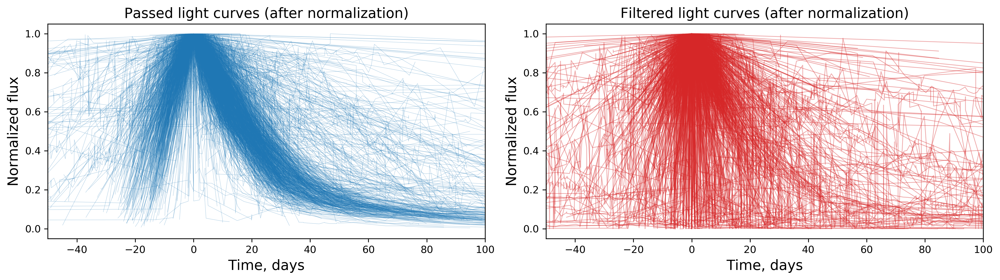

In [24]:
from matplotlib.lines import Line2D

good_line = [Line2D([0], [0], color='C0', lw=4)]
bad_line = [Line2D([0], [0], color='C3', lw=4)]

fig, ax = plt.subplots(1, 2, figsize=(14, 4), dpi=300)

for i in range(good_data.shape[0]):
    x = good_data.loc[i, 'x_shifted']
    y = good_data.loc[i, 'y_normed']
    ax[0].plot(x, y, alpha=0.4, color='C0', linewidth=0.3)

for i in range(bad_data.shape[0]):
    x = bad_data.loc[i, 'x_shifted']
    y = bad_data.loc[i, 'y_normed']
    ax[1].plot(x, y, alpha=0.4, color='C3', linewidth=0.7)
    
#ax[0].legend(good_line, ['$p_{\chi^2} <$ 0.001 (Left)'])
ax[0].set_title('Passed light curves (after normalization)', fontsize=14)
ax[0].set_ylabel(r'Normalized flux', fontsize=14)
ax[0].set_xlabel('Time, days', fontsize=14)
ax[0].set_xlim(-50, 100)

ax[1].set_title('Filtered light curves (after normalization)', fontsize=14)
#ax[1].legend(bad_line, ['$p_{\chi^2} \geq$ 0.001 (Cut)'])
ax[1].set_ylabel(r'Normalized flux', fontsize=14)
ax[1].set_xlabel('Time, days', fontsize=14)
ax[1].set_xlim(-50, 100)

plt.tight_layout()
plt.savefig(fname='images/cut_curves1.png', dpi=300, format='png')
plt.show()

In [25]:
data = data[(data.pval < 0.001) & (data.size_r >= 4)].reset_index()

In [26]:
data.shape

(1527, 14)

In [27]:
data[(data.spec_class == 1) & (data.is_ia == 1)].shape

(392, 14)

In [28]:
print("Selected Ia: ", len(data[data.is_ia == 1]))
print("Selected Not-Ia: ", len(data[data.is_ia == 0]))

Selected Ia:  1184
Selected Not-Ia:  343


#### Results

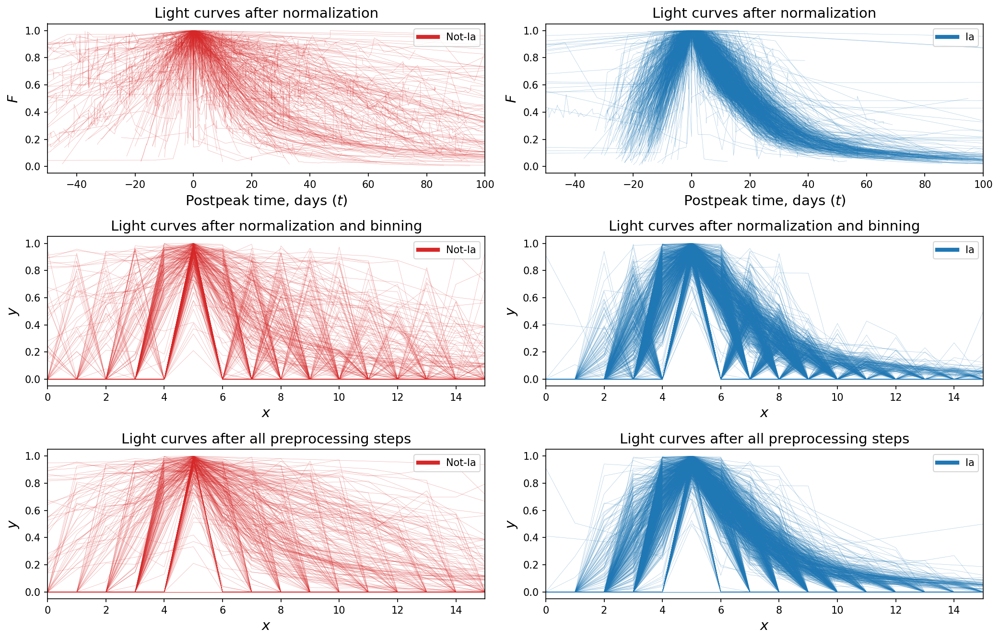

In [29]:
fig, ax = plt.subplots(3, 2, figsize=(14, 9), dpi=150)

custom_lines = [Line2D([0], [0], color='C3', lw=4),
                Line2D([0], [0], color='C0', lw=4)]

for i in range(data[data.is_ia == 0].shape[0]):
    x = data[data.is_ia == 0].reset_index().loc[i, 'x_shifted']
    y = data[data.is_ia == 0].reset_index().loc[i, 'y_normed']
    ax[0][0].plot(x, y, alpha=0.4, color='C3', linewidth=0.3)
    
ax[0][0].set_title('Light curves after normalization', fontsize=14)
ax[0][0].set_ylabel('$F$', fontsize=14)
ax[0][0].set_xlabel('Postpeak time, days $(t)$', fontsize=14)
ax[0][0].set_xlim(-50, 100)
ax[0][0].legend([custom_lines[0]], ['Not-Ia'], loc='upper right')

for i in range(data[data.is_ia == 0].shape[0]):
    y = data[data.is_ia == 0].reset_index().loc[i, 'binarized']
    x = np.linspace(0, 15, 16)
    ax[1][0].plot(x, y, alpha=0.4, color='C3', linewidth=0.3)
    
ax[1][0].set_title('Light curves after normalization and binning', fontsize=14)
ax[1][0].set_ylabel('$y$', fontsize=14)
ax[1][0].set_xlabel('$x$', fontsize=14)
ax[1][0].set_xlim(0, 15)
ax[1][0].legend([custom_lines[0]], ['Not-Ia'], loc='upper right')

for i in range(data[data.is_ia == 0].shape[0]):
    y = data[data.is_ia == 0].reset_index().loc[i, 'interpolated']
    x = np.linspace(0, 15, 16)
    ax[2][0].plot(x, y, alpha=0.4, color='C3', linewidth=0.3)
    
ax[2][0].set_title('Light curves after all preprocessing steps', fontsize=14)
ax[2][0].set_ylabel('$y$', fontsize=14)
ax[2][0].set_xlabel('$x$', fontsize=14)
ax[2][0].set_xlim(0, 15)
ax[2][0].legend([custom_lines[0]], ['Not-Ia'], loc='upper right')
    
for i in range(data[data.is_ia == 1].shape[0]):
    x = data[data.is_ia == 1].reset_index().loc[i, 'x_shifted']
    y = data[data.is_ia == 1].reset_index().loc[i, 'y_normed']
    ax[0][1].plot(x, y, alpha=0.4, color='C0', linewidth=0.3)
    
ax[0][1].set_title('Light curves after normalization', fontsize=14)
ax[0][1].set_ylabel('$F$', fontsize=14)
ax[0][1].set_xlabel('Postpeak time, days $(t)$', fontsize=14)
ax[0][1].set_xlim(-50, 100)
ax[0][1].legend([custom_lines[1]], ['Ia'], loc='upper right')

for i in range(data[data.is_ia == 1].shape[0]):
    y = data[data.is_ia == 1].reset_index().loc[i, 'binarized']
    x = np.linspace(0, 15, 16)
    ax[1][1].plot(x, y, alpha=0.4, color='C0', linewidth=0.3)
    
ax[1][1].set_title('Light curves after normalization and binning', fontsize=14)
ax[1][1].set_ylabel('$y$', fontsize=14)
ax[1][1].set_xlabel('$x$', fontsize=14)
ax[1][1].set_xlim(0, 15)
ax[1][1].legend([custom_lines[1]], ['Ia'], loc='upper right')

for i in range(data[data.is_ia == 1].shape[0]):
    y = data[data.is_ia == 1].reset_index().loc[i, 'interpolated']
    x = np.linspace(0, 15, 16)
    ax[2][1].plot(x, y, alpha=0.4, color='C0', linewidth=0.3)
    
ax[2][1].set_title('Light curves after all preprocessing steps', fontsize=14)
ax[2][1].set_ylabel('$y$', fontsize=14)
ax[2][1].set_xlabel('$x$', fontsize=14)
ax[2][1].set_xlim(0, 15)
ax[2][1].legend([custom_lines[1]], ['Ia'], loc='upper right')
    
    
plt.tight_layout()
plt.savefig(fname='images/preprocessing1.png', dpi=300, format='png')
plt.show()

In [30]:
data.head()

,index,sn_name,type,size_r,curve_r,spec_class,rms,rms_for_pval,is_ia,pval,y_normed,x_shifted,binarized,interpolated
0,0,ASASSN-13ax,Dwarf Nova,122,"[[56477.4482, nan, 1.8373842952834476e-06, 7.4...",0,9186.448800,1.111560e+06,0,0.0,"[0.9596657603342269, 0.9411091588919488, 0.984...","[-0.023999999997613486, -0.022799999998824205,...","[0, 0, 0, 0, 0, 0.6418471678280199, 0.35465847...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.6418471678280198, ..."
1,1,ASASSN-13cu,Ia,4,"[[56531.4793028785, nan, 1.9052852266272632e-0...",0,2674.142946,8.022429e+03,1,0.0,"[0.9975162976050261, 1.0, 0.04556170837990151,...","[-0.011043078702641651, 0.0, 87.73841054689547...","[0, 0, 0, 0, 0, 0.998758148802513, 0, 0, 0, 0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.9987581488025128, ..."
2,4,ASASSN-14ae,TDE,45,"[[56684.1203, nan, 3.8508801287880484e-07, 8.2...",1,433.613743,1.907900e+04,0,0.0,"[0.8521577537904473, 1.0, 0.6349214508778149, ...","[-0.08889999999519205, 0.0, 3.69720000000234, ...","[0, 0, 0, 0, 0, 0.7061142055337216, 0.71414211...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.7061142055337216, ..."
3,6,ASASSN-14bb,Ia,8,"[[56798.8868, nan, 8.312276860137896e-07, 3.52...",0,532.439311,3.727075e+03,1,0.0,"[0.989737441913218, 0.9884620497450024, 1.0, 0...","[-4.923999999999069, -0.0015999999959603883, 0...","[0, 0, 0, 0, 0.989737441913218, 0.976695946436...","[0.0, 0.0, 0.0, 0.0, 0.9897374419132179, 0.976..."
4,7,ASASSN-14dq,II;IIb,97,"[[56850.09, nan, 4.988844874600117e-07, 5.9733...",0,4474.522320,4.295541e+05,0,0.0,"[1.0, 0.9471090794701602, 0.9418895965228418, ...","[0.0, 0.0020000000004074536, 9.978000000002794...","[0, 0, 0, 0, 0, 0.9735545397350801, 0.92371376...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.9735545397350801, ..."


## Features Generation

In [31]:
def generate_features(row):
    return rolling_ratio(row.interpolated)

data['rolling_ratios'] = data.apply(generate_features, axis=1)

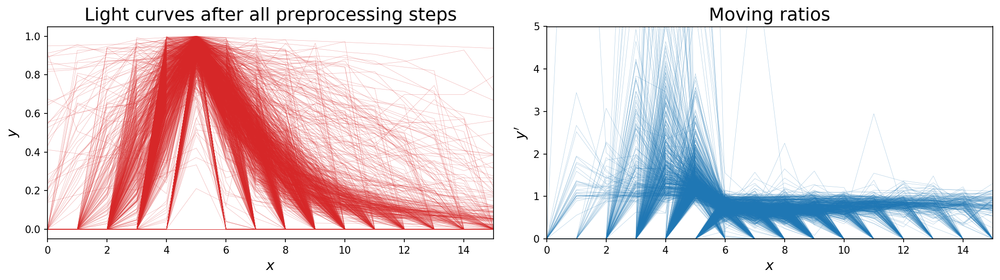

In [32]:
fig, ax = plt.subplots(1, 2, figsize=(14, 4), dpi=150)

for i in range(data.shape[0]):
    y = data.loc[i, 'interpolated']
    x = np.linspace(0, 15, 16)
    ax[0].plot(x, y, alpha=0.4, color='C3', linewidth=0.3)
    
for i in range(data.shape[0]):
    y = data.loc[i, 'rolling_ratios']
    x = np.linspace(0, 15, 16)
    ax[1].plot(x, y, alpha=0.4, color='C0', linewidth=0.3)
    
ax[0].set_title('Light curves after all preprocessing steps',  fontsize=18)
ax[0].set_xlim(0, 15)
ax[1].set_title('Moving ratios', fontsize=18)
ax[1].set_ylim(0, 5)
ax[1].set_xlim(0, 15)

ax[0].set_xlabel('$x$', fontsize=14)
ax[0].set_ylabel('$y$', fontsize=14)
ax[1].set_xlabel('$x$', fontsize=14)
ax[1].set_ylabel("$y'$", fontsize=14)
    
plt.tight_layout()
plt.savefig(fname='images/feature_gen.png', dpi=300, format='png')
plt.show()

In [33]:
data.head()

,index,sn_name,type,size_r,curve_r,spec_class,rms,rms_for_pval,is_ia,pval,y_normed,x_shifted,binarized,interpolated,rolling_ratios
0,0,ASASSN-13ax,Dwarf Nova,122,"[[56477.4482, nan, 1.8373842952834476e-06, 7.4...",0,9186.448800,1.111560e+06,0,0.0,"[0.9596657603342269, 0.9411091588919488, 0.984...","[-0.023999999997613486, -0.022799999998824205,...","[0, 0, 0, 0, 0, 0.6418471678280199, 0.35465847...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.6418471678280198, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.5525590776831..."
1,1,ASASSN-13cu,Ia,4,"[[56531.4793028785, nan, 1.9052852266272632e-0...",0,2674.142946,8.022429e+03,1,0.0,"[0.9975162976050261, 1.0, 0.04556170837990151,...","[-0.011043078702641651, 0.0, 87.73841054689547...","[0, 0, 0, 0, 0, 0.998758148802513, 0, 0, 0, 0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.9987581488025128, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.8941161851881..."
2,4,ASASSN-14ae,TDE,45,"[[56684.1203, nan, 3.8508801287880484e-07, 8.2...",1,433.613743,1.907900e+04,0,0.0,"[0.8521577537904473, 1.0, 0.6349214508778149, ...","[-0.08889999999519205, 0.0, 3.69720000000234, ...","[0, 0, 0, 0, 0, 0.7061142055337216, 0.71414211...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.7061142055337216, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0113691349509..."
3,6,ASASSN-14bb,Ia,8,"[[56798.8868, nan, 8.312276860137896e-07, 3.52...",0,532.439311,3.727075e+03,1,0.0,"[0.989737441913218, 0.9884620497450024, 1.0, 0...","[-4.923999999999069, -0.0015999999959603883, 0...","[0, 0, 0, 0, 0.989737441913218, 0.976695946436...","[0.0, 0.0, 0.0, 0.0, 0.9897374419132179, 0.976...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.9868232776446527, ..."
4,7,ASASSN-14dq,II;IIb,97,"[[56850.09, nan, 4.988844874600117e-07, 5.9733...",0,4474.522320,4.295541e+05,0,0.0,"[1.0, 0.9471090794701602, 0.9418895965228418, ...","[0.0, 0.0020000000004074536, 9.978000000002794...","[0, 0, 0, 0, 0, 0.9735545397350801, 0.92371376...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.9735545397350801, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.9488053611102..."


In [34]:
init_features = np.stack(data.interpolated.values)
generated_features = np.stack(data.rolling_ratios.values)
print('Length of the initial vector:', init_features[0].shape[0])
print('Length of the generated vector:', generated_features[0].shape[0])

Length of the initial vector: 16
Length of the generated vector: 16


In [35]:
features_df = pd.DataFrame(np.concatenate((init_features, generated_features), axis=1))
features_df.columns = ['x_' + str(i) for i in range(16)] + ['d_' + str(i) for i in range(16)]
features_df.head()

,x_0,x_1,x_2,x_3,x_4,x_5,x_6,x_7,x_8,x_9,...,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15
0,0.0,0.0,0.0,0.0,0.000000,0.641847,0.354658,0.145714,0.124969,0.000000,...,0.552559,0.410856,0.857637,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.0,0.0,0.0,0.0,0.000000,0.998758,0.893006,0.787254,0.681501,0.575749,...,0.894116,0.881577,0.865669,0.844824,0.816322,0.774993,0.709666,0.590887,0.307630,0.000000
2,0.0,0.0,0.0,0.0,0.000000,0.706114,0.714142,0.433914,0.509347,0.519326,...,1.011369,0.607602,1.173843,1.019592,0.880085,0.863747,0.957937,0.000000,0.000000,0.000000
3,0.0,0.0,0.0,0.0,0.989737,0.976696,0.797040,0.697048,0.000000,0.000000,...,0.816057,0.874546,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.0,0.0,0.0,0.0,0.000000,0.973555,0.923714,0.800909,0.738812,0.682432,...,0.948805,0.867053,0.922467,0.923688,0.953105,0.875898,0.927148,0.919208,0.720705,0.539576


In [36]:
data = pd.concat([data.reset_index(drop=True), features_df.reset_index(drop=True)], axis=1)

In [37]:
data.head()

,index,sn_name,type,size_r,curve_r,spec_class,rms,rms_for_pval,is_ia,pval,...,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15
0,0,ASASSN-13ax,Dwarf Nova,122,"[[56477.4482, nan, 1.8373842952834476e-06, 7.4...",0,9186.448800,1.111560e+06,0,0.0,...,0.552559,0.410856,0.857637,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,1,ASASSN-13cu,Ia,4,"[[56531.4793028785, nan, 1.9052852266272632e-0...",0,2674.142946,8.022429e+03,1,0.0,...,0.894116,0.881577,0.865669,0.844824,0.816322,0.774993,0.709666,0.590887,0.307630,0.000000
2,4,ASASSN-14ae,TDE,45,"[[56684.1203, nan, 3.8508801287880484e-07, 8.2...",1,433.613743,1.907900e+04,0,0.0,...,1.011369,0.607602,1.173843,1.019592,0.880085,0.863747,0.957937,0.000000,0.000000,0.000000
3,6,ASASSN-14bb,Ia,8,"[[56798.8868, nan, 8.312276860137896e-07, 3.52...",0,532.439311,3.727075e+03,1,0.0,...,0.816057,0.874546,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,7,ASASSN-14dq,II;IIb,97,"[[56850.09, nan, 4.988844874600117e-07, 5.9733...",0,4474.522320,4.295541e+05,0,0.0,...,0.948805,0.867053,0.922467,0.923688,0.953105,0.875898,0.927148,0.919208,0.720705,0.539576


In [38]:
X = data.loc[:, 'x_0':'d_15'].values
y = data['is_ia'].values
indices = np.arange(data.shape[0])

In [39]:
import pickle

with open('X_osc.pickle', 'wb') as f:
    pickle.dump(X, f)

In [40]:
with open('y_osc.pickle', 'wb') as f:
    pickle.dump(y, f)

In [41]:
data.shape

(1527, 47)

## Cross-Validation Method (K-Fold)

In [42]:
def kfold(clf, X, y, clf_name='any'):
    cv = StratifiedKFold(n_splits=5, random_state=123, shuffle=True)
    results = pd.DataFrame(columns=['training_score', 'test_score'])
    predictions = []
    test_indices = []
    
    for (train, test), i in zip(cv.split(X, y), range(5)):
        try:
            if clf_name != 'any':
                clf.fit(X[train], y[train], epochs=50, validation_split=.1, verbose=0)
                y_pred = clf.predict(X[test])
            else:
                clf.fit(X[train], y[train])
                y_pred = clf.predict_proba(X[test])[:, 1]
        except:
            clf.fit(X[train], y[train])
            y_pred = clf.predict_proba(X[test])[:, 1]
        predictions.append(y_pred)
        test_indices.append(test)
        
    return predictions, test_indices

## Models

In [43]:
def get_predictions(X, predictions, test_indices):
    results = pd.DataFrame(columns=['index', 'y_pred'])
    results['index'] = np.arange(X.shape[0])
    for i, (pred, ind) in enumerate(zip(predictions, test_indices)):
        results.at[ind, 'y_pred'] = pred
    return results['y_pred'].values

#### Baseline: Logistic Regression

In [44]:
from sklearn.linear_model import LogisticRegression

logreg = LogisticRegression(penalty='l2',
                            random_state=42,
                            solver='lbfgs',
                            max_iter=1000)

predictions, test_indices = kfold(logreg, X, y)

In [45]:
data['logreg_pred'] = get_predictions(X, predictions, test_indices)

#### Random Forest

In [46]:
from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(n_estimators=1000,
                            min_samples_split=10, 
                            min_samples_leaf=2, 
                            max_features='auto',
                            bootstrap=True, 
                            max_depth=10, 
                            n_jobs=4, 
                            random_state=25)

predictions, test_indices = kfold(rf, X, y)

In [47]:
data['rf_pred'] = get_predictions(X, predictions, test_indices)

In [48]:
filename = 'rf_osc_model.sav'
pickle.dump(rf, open(filename, 'wb'))

#### XGBoost

In [49]:
from xgboost import XGBClassifier

xgb = XGBClassifier(n_estimators=1000, 
                    learning_rate=0.02, 
                    max_depth=6, 
                    subsample=0.8, 
                    colsample=0.7, 
                    min_child_weight=1, 
                    n_jobs=3)

predictions, test_indices = kfold(xgb, X, y)

In [50]:
data['xgb_pred'] = get_predictions(X, predictions, test_indices)

#### CatBoost

#### One-Layer NN

In [51]:
import keras
from keras.layers import Dense
from keras.models import Sequential
from keras.callbacks import History 
from keras.utils import plot_model, to_categorical
from keras.optimizers import SGD
import sklearn.metrics as metrics


nn = Sequential()
nn.add(Dense(32, activation='relu', input_dim=32))
nn.add(Dense(1, activation='sigmoid'))

nn.compile(optimizer='adam', 
              loss='binary_crossentropy', 
              metrics=['accuracy'])

predictions, test_indices = kfold(nn, X, y, 'nn')

Using TensorFlow backend.


In [52]:
data['nn'] = get_predictions(X, predictions, test_indices)

In [53]:
data.shape

(1527, 51)

In [54]:
data.to_csv("../data/selected_new_article_data.csv", index=False)

## Model Evaluation (Random Forest)

#### Table of Scores

In [55]:
scores_dict = {}

for model_pred in data.loc[:, 'logreg_pred':].columns:
    y_pred = data[model_pred].values
    auc = roc_auc_score(data.is_ia, y_pred)
    acc = accuracy_score(data.is_ia, y_pred>=0.5)
    f1 = f1_score(data.is_ia, y_pred>=0.5)
    pr = precision_score(data.is_ia, y_pred>=0.5)
    rec = recall_score(data.is_ia, y_pred>=0.5)
    scores_dict[model_pred] = [auc, acc, f1, pr, rec]

In [56]:
scores_df = pd.DataFrame(scores_dict)
scores_df['score'] = ['AUC', 'Acc', 'F1-score', 'Precision', 'Recall']
scores_df.set_index('score')

,logreg_pred,rf_pred,xgb_pred,nn
score,,,,
AUC,0.801206,0.876464,0.866250,0.861473
Acc,0.860511,0.864440,0.858546,0.862475
F1-score,0.915844,0.916834,0.911837,0.916201
Precision,0.860431,0.874330,0.882306,0.868381
Recall,0.978885,0.963682,0.943412,0.969595


In [57]:
std_errors = {}

for model_pred in data.loc[:, 'logreg_pred':].columns:
    bs_auc = []
    bs_acc = []
    bs_f1 = []
    bs_pr = []
    bs_rec = []
    for i in range(1000):
        idx = np.random.choice([i for i in range(data.shape[0])], data.shape[0])
        bs_y_test = data.is_ia.values[idx]
        bs_y_pred = data[model_pred].values[idx]
        bs_auc.append(roc_auc_score(bs_y_test, bs_y_pred))
        bs_acc.append(accuracy_score(bs_y_test, bs_y_pred>=0.5))
        bs_f1.append(f1_score(bs_y_test, bs_y_pred>=0.5))
        bs_pr.append(precision_score(bs_y_test, bs_y_pred>=0.5))
        bs_rec.append(recall_score(bs_y_test, bs_y_pred>=0.5))
        
    std_errors[model_pred] = [np.std(bs_auc), np.std(bs_acc), np.std(bs_f1), np.std(bs_pr), np.std(bs_rec)]
    print('Done ' + model_pred)

Done logreg_pred
Done rf_pred
Done xgb_pred
Done nn


In [58]:
errs = pd.DataFrame(std_errors)
errs.index = ['AUC', 'Acc', 'F1-score', 'Precision', 'Recall']
errs

,logreg_pred,rf_pred,xgb_pred,nn
AUC,0.015812,0.010314,0.011725,0.012518
Acc,0.008679,0.008226,0.008822,0.008753
F1-score,0.005689,0.005485,0.005930,0.005707
Precision,0.009341,0.008868,0.008956,0.009277
Recall,0.004239,0.005361,0.006757,0.004818


In [59]:
spec_scores_dict = {}

for model_pred in data.loc[:, 'logreg_pred':].columns:
    y_pred = data[data.spec_class == 1][model_pred].values
    auc = roc_auc_score(data[data.spec_class == 1].is_ia, y_pred)
    acc = accuracy_score(data[data.spec_class == 1].is_ia, y_pred>=0.5)
    f1 = f1_score(data[data.spec_class == 1].is_ia, y_pred>=0.5)
    pr = precision_score(data[data.spec_class == 1].is_ia, y_pred>=0.5)
    rec = recall_score(data[data.spec_class == 1].is_ia, y_pred>=0.5)
    spec_scores_dict[model_pred] = [auc, acc, f1, pr, rec]

In [60]:
spec_scores_df = pd.DataFrame(spec_scores_dict)
spec_scores_df['score'] = ['AUC', 'Acc', 'F1-score', 'Precision', 'Recall']
spec_scores_df.set_index('score')

,logreg_pred,rf_pred,xgb_pred,nn
score,,,,
AUC,0.783873,0.892060,0.887712,0.859737
Acc,0.879167,0.887500,0.893750,0.872917
F1-score,0.930456,0.934940,0.937576,0.926239
Precision,0.877828,0.885845,0.901176,0.880460
Recall,0.989796,0.989796,0.977041,0.977041


#### Confusion Matrix

In [61]:
data.head()

,index,sn_name,type,size_r,curve_r,spec_class,rms,rms_for_pval,is_ia,pval,...,d_10,d_11,d_12,d_13,d_14,d_15,logreg_pred,rf_pred,xgb_pred,nn
0,0,ASASSN-13ax,Dwarf Nova,122,"[[56477.4482, nan, 1.8373842952834476e-06, 7.4...",0,9186.448800,1.111560e+06,0,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.683464,0.388571,0.237813,0.823709
1,1,ASASSN-13cu,Ia,4,"[[56531.4793028785, nan, 1.9052852266272632e-0...",0,2674.142946,8.022429e+03,1,0.0,...,0.816322,0.774993,0.709666,0.590887,0.307630,0.000000,0.279852,0.198627,0.344758,0.0542415
2,4,ASASSN-14ae,TDE,45,"[[56684.1203, nan, 3.8508801287880484e-07, 8.2...",1,433.613743,1.907900e+04,0,0.0,...,0.880085,0.863747,0.957937,0.000000,0.000000,0.000000,0.24853,0.221915,0.0267639,0.0792057
3,6,ASASSN-14bb,Ia,8,"[[56798.8868, nan, 8.312276860137896e-07, 3.52...",0,532.439311,3.727075e+03,1,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.90995,0.794629,0.162863,0.767512
4,7,ASASSN-14dq,II;IIb,97,"[[56850.09, nan, 4.988844874600117e-07, 5.9733...",0,4474.522320,4.295541e+05,0,0.0,...,0.953105,0.875898,0.927148,0.919208,0.720705,0.539576,0.0436741,0.0093224,0.00236995,6.08651e-05


In [62]:
from sklearn.metrics import confusion_matrix

tn, fp, fn, tp = confusion_matrix(data.is_ia.values, data['rf_pred'].values >= 0.5).ravel()

(tn, fp, fn, tp)

(179, 164, 43, 1141)

# ROC Curve

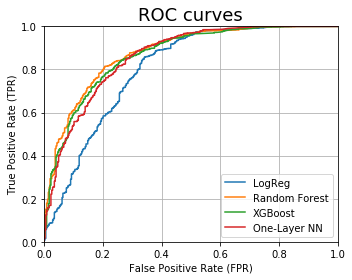

In [63]:
fig, ax = plt.subplots(1, 1, figsize=(5, 4))

models = ['LogReg', 'Random Forest', 'XGBoost', 'One-Layer NN']

ax.set_ylabel('True Positive Rate (TPR)')
ax.set_xlabel('False Positive Rate (FPR)')
ax.set_xlim(0., 1)
ax.set_ylim(0., 1)
ax.set_title('ROC сurves', fontsize=18)
ax.grid(b=0.1)

colors = ['C0', 'C1', 'C2', 'C3']

for i, model_pred in enumerate(data.loc[:, 'logreg_pred':].columns):
    y_pred = data[model_pred].values
    fpr, tpr, thresholds = roc_curve(data.is_ia, y_pred)
    ax.plot(fpr, tpr, linewidth=1.5, label=models[i], color=colors[i])
    
ax.legend()
    
plt.tight_layout()
plt.savefig(fname='images/roc_curves.pdf', format='pdf')
plt.show()

In [64]:
y_pred = data['rf_pred'].values
y_true = data.is_ia.values

with open('OSC_rf_y_pred.pickle', 'wb') as f:
    pickle.dump(y_pred, f)
    
with open('OSC_y_true.pickle', 'wb') as f:
    pickle.dump(y_true, f)

#### Spec ROC Curve

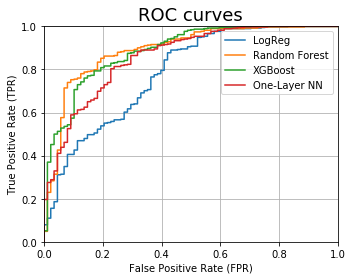

In [65]:
fig, ax = plt.subplots(1, 1, figsize=(5, 4))

models = ['LogReg', 'Random Forest', 'XGBoost', 'One-Layer NN']

ax.set_ylabel('True Positive Rate (TPR)')
ax.set_xlabel('False Positive Rate (FPR)')
ax.set_xlim(0., 1)
ax.set_ylim(0., 1)
ax.set_title('ROC сurves', fontsize=18)
ax.grid(b=0.1)

colors = ['C0', 'C1', 'C2', 'C3']

for i, model_pred in enumerate(data.loc[:, 'logreg_pred':].columns):
    y_pred = data[data.spec_class == 1][model_pred].values
    fpr, tpr, thresholds = roc_curve(data[data.spec_class == 1].is_ia, y_pred)
    ax.plot(fpr, tpr, linewidth=1.5, label=models[i], color=colors[i])
    
ax.legend()
    
plt.tight_layout()
plt.savefig(fname='images/roc_curves_spec.pdf', format='pdf')
plt.show()

#### Probablity Distribution Histogram

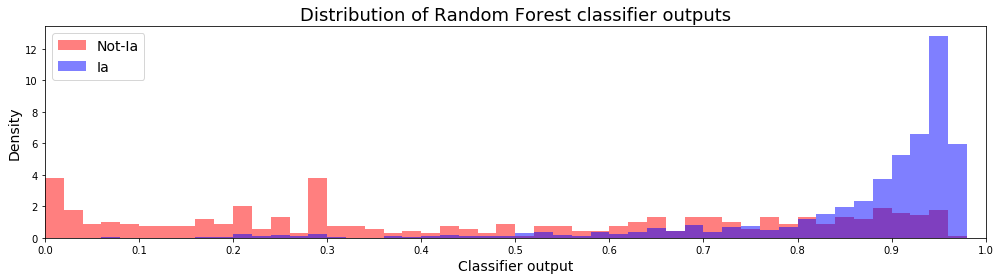

In [66]:
y_pred = data.rf_pred.values

fig, ax = plt.subplots(figsize=(14, 4))

plt.tight_layout()

ax.set_title('Distribution of Random Forest classifier outputs', fontsize=18)
ax.set_xticks(np.linspace(0, 1, 11))
ax.set_xlabel('Сlassifier output', fontsize=14)
ax.set_ylabel('Density', fontsize=14)
ax.hist(y_pred[data.is_ia.values == 0].reshape(-1, 1), 
        bins=np.linspace(0, 1, 51), 
        density=True, 
        label='Not-Ia', 
        color='r', alpha=0.5)
ax.hist(y_pred[data.is_ia.values == 1].reshape(-1, 1), 
        bins=np.linspace(0, 1, 51), 
        density=True, 
        label='Ia', 
        color='b', 
        alpha=0.5)
ax.legend(loc='best', fontsize=14)
ax.set_xlim(0., 1)

plt.tight_layout()
plt.savefig(fname='images/prob_dist.pdf', format='pdf')
plt.show()

In [67]:
data['claimed_type'] = data.type.apply(lambda x: x.split(';')[0])

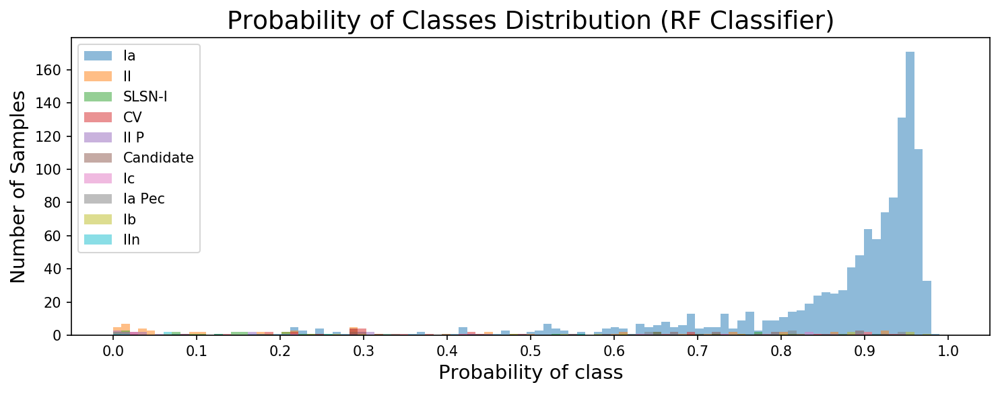

In [68]:
fig, ax = plt.subplots(figsize=(10, 4), dpi=150)

for ct in data.claimed_type.value_counts().head(10).index:
    fdata = data[data.claimed_type == ct].reset_index(drop=True).copy()
    y_pred = fdata.rf_pred.values

    ax.hist(y_pred.reshape(-1, 1), 
            bins=np.linspace(0, 1, 100), 
            label=ct, alpha=0.5)

ax.legend(loc='best')
ax.set_title('Probability of Classes Distribution (RF Classifier)', fontsize=18)
ax.set_xticks(np.linspace(0, 1, 11))
ax.set_xlabel('Probability of class', fontsize=14)
ax.set_ylabel('Number of Samples', fontsize=14)
plt.tight_layout()
plt.show()

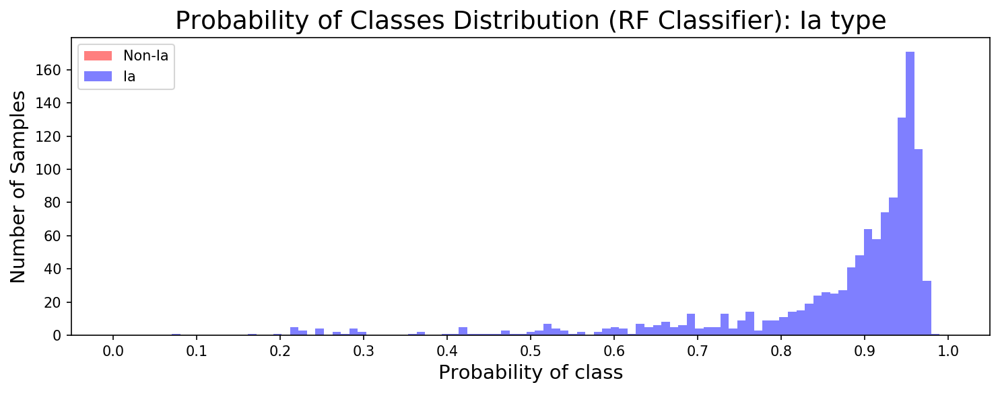

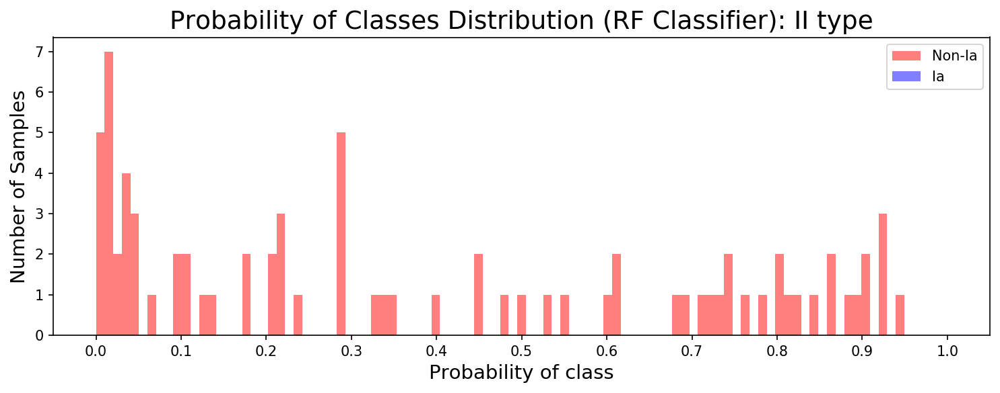

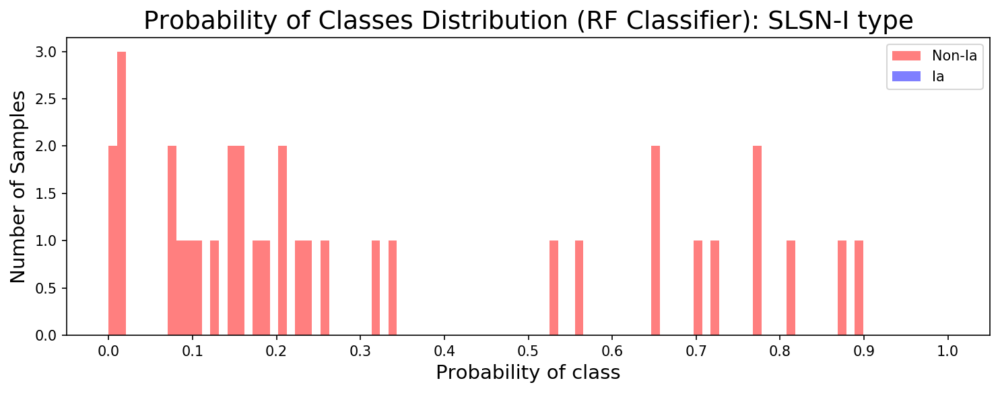

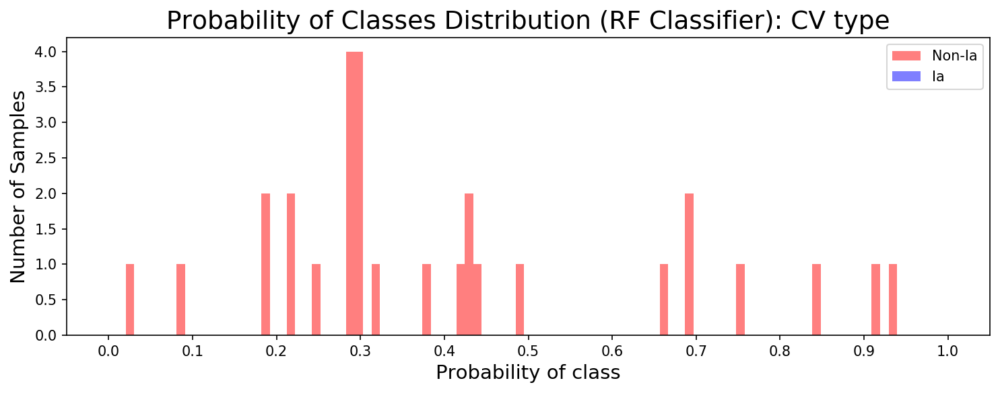

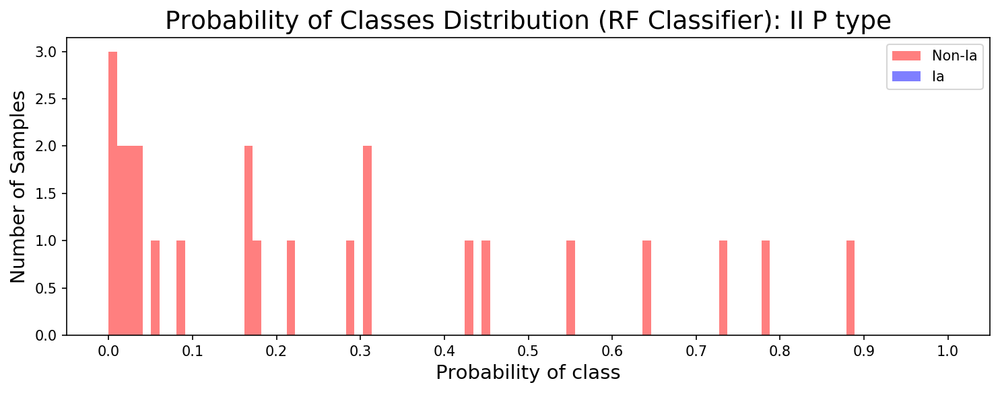

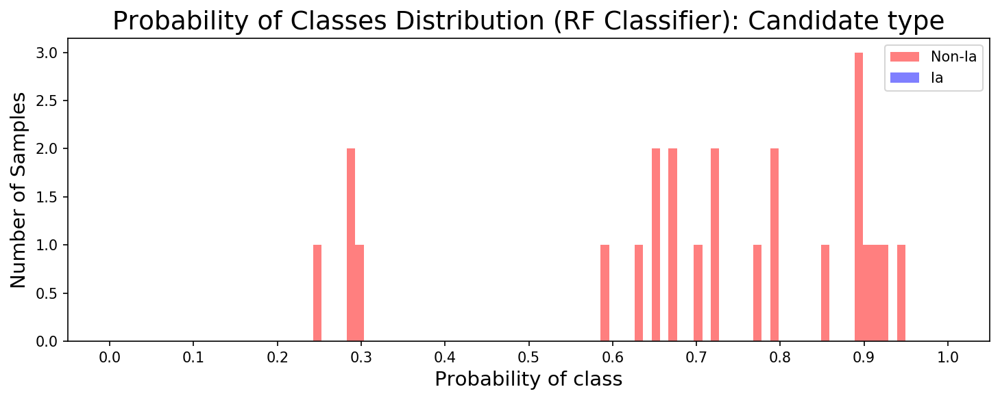

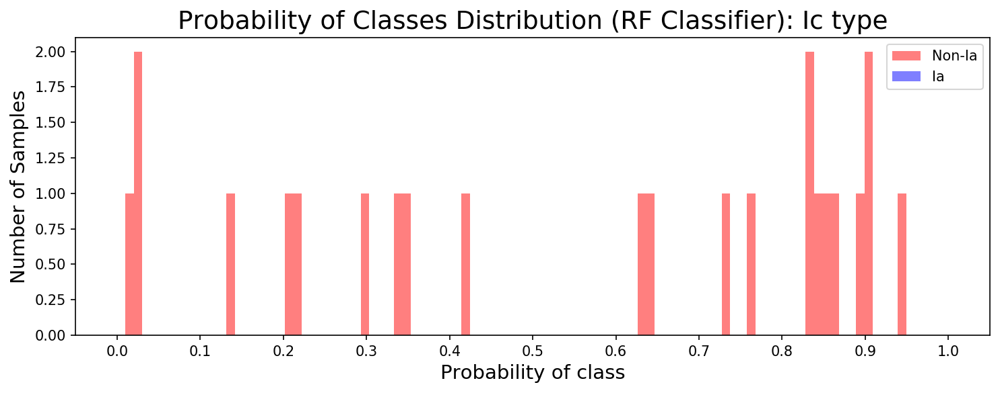

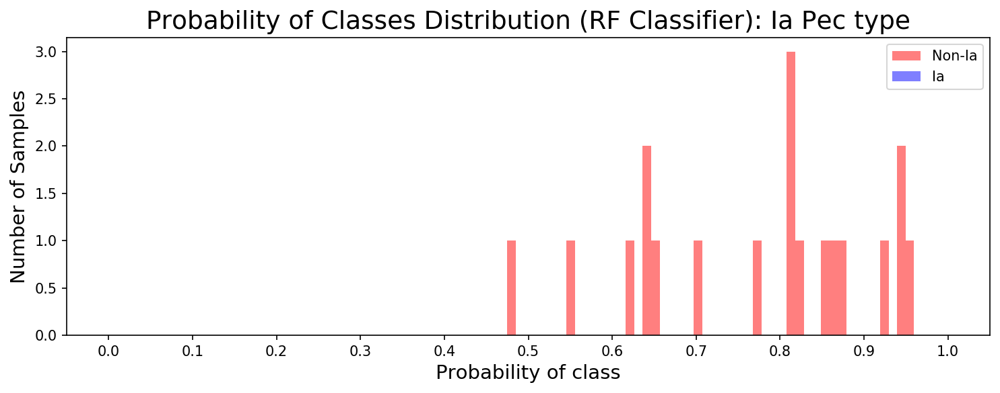

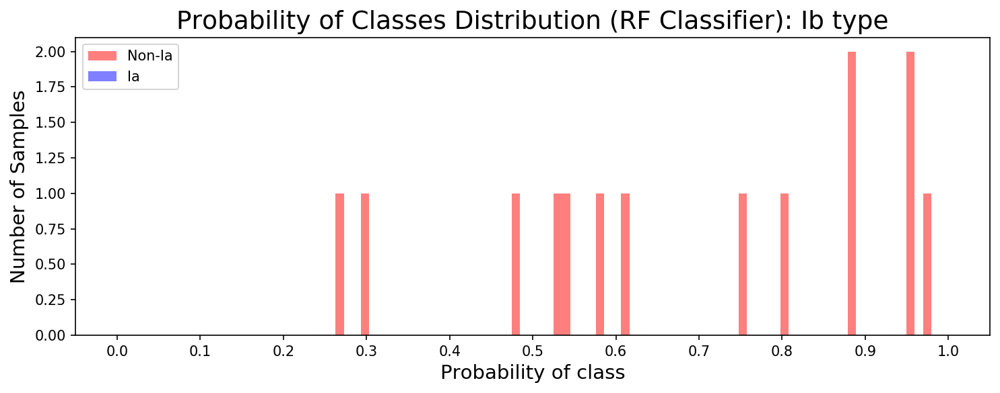

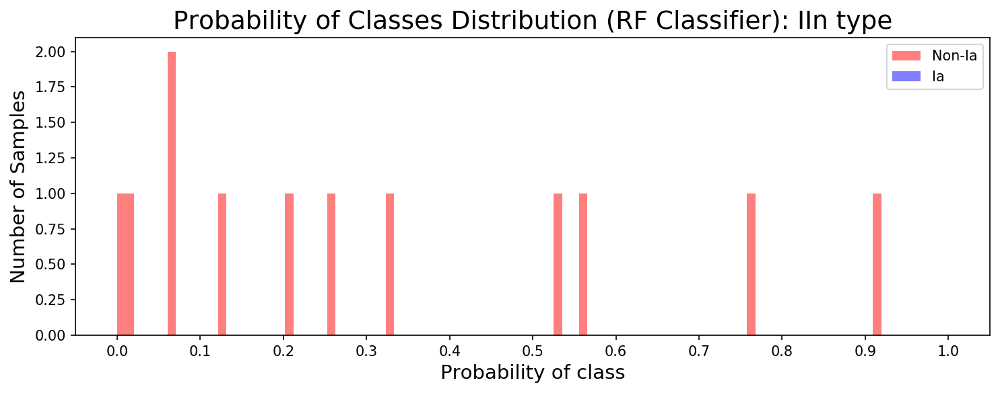

In [69]:
for ct in data.claimed_type.value_counts().head(10).index:
    fdata = data[data.claimed_type == ct].reset_index(drop=True).copy()
    y_pred = fdata.rf_pred.values
    
    fig, ax = plt.subplots(figsize=(10, 4), dpi=150)

    ax.hist(y_pred[fdata.is_ia.values == 0].reshape(-1, 1), 
            bins=np.linspace(0, 1, 100),
            density=False,
            label='Non-Ia', color='r', alpha=0.5)
    
    ax.hist(y_pred[fdata.is_ia.values == 1].reshape(-1, 1), 
            bins=np.linspace(0, 1, 100),
            density=False,
            label='Ia', color='b', alpha=0.5)

    ax.legend(loc='best')
    ax.set_title('Probability of Classes Distribution (RF Classifier): {0} type'.format(ct), fontsize=18)
    ax.set_xticks(np.linspace(0, 1, 11))
    ax.set_xlabel('Probability of class', fontsize=14)
    ax.set_ylabel('Number of Samples', fontsize=14)
    plt.tight_layout()
    plt.show()

#### Features Importance

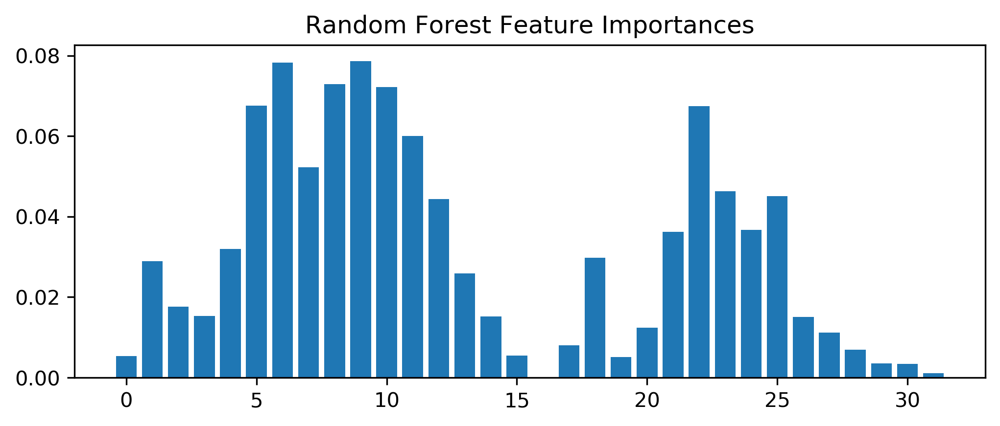

In [70]:
rf = RandomForestClassifier(n_estimators=1000,
                            min_samples_split=10, 
                            min_samples_leaf=2, 
                            max_features='auto',
                            bootstrap=True, 
                            max_depth=10, 
                            n_jobs=4, 
                            random_state=25)

rf.fit(X, y)

fig, ax = plt.subplots(figsize=(8, 3), dpi=300)
ax.bar(x=np.arange(len(rf.feature_importances_)), height=rf.feature_importances_)
ax.set_title('Random Forest Feature Importances')
plt.show()

#### Confusion Matrix Analysis

In [71]:
TP_data = data[(data.is_ia == 1) & (data.rf_pred >= 0.5)].copy()
FP_data = data[(data.is_ia == 0) & (data.rf_pred >= 0.5)].copy()
TN_data = data[(data.is_ia == 0) & (data.rf_pred < 0.5)].copy()
FN_data = data[(data.is_ia == 1) & (data.rf_pred < 0.5)].copy()

In [72]:
FN_data.size_r.median()

6.0

In [73]:
TP_data.size_r.median()

7.0

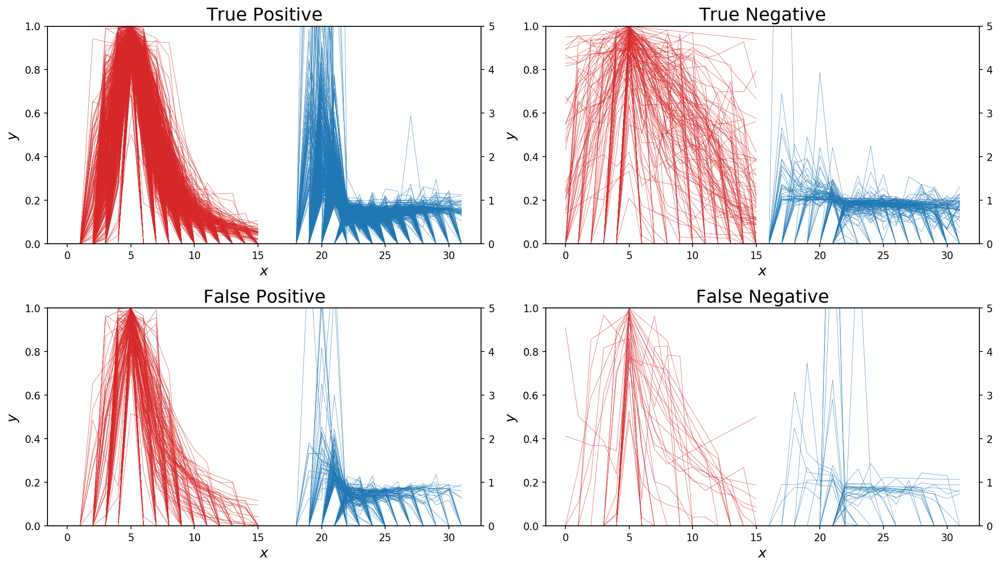

In [74]:
fig, ax = plt.subplots(2, 2, figsize=(14, 8), dpi=150)

ax_twin_tp = ax[0][0].twinx()
for i in range(TP_data.shape[0]):
    y = TP_data.reset_index().loc[i, 'x_0':'x_15'].values
    y_d = TP_data.reset_index().loc[i, 'd_0':'d_15'].values
    x = np.arange(len(y))
    x_d = np.arange(16, 32)
    ax[0][0].plot(x, y, color='C3', linewidth=0.3)
    ax_twin_tp.plot(x_d, y_d, color='C0', linewidth=0.3)
    ax[0][0].set_ylim(0., 1)
    ax_twin_tp.set_ylim(0., 5)
    ax[0][0].set_title('True Positive', fontsize=18)
    
ax_twin_tn = ax[0][1].twinx()
for i in range(TN_data.shape[0]):
    y = TN_data.reset_index().loc[i, 'x_0':'x_15'].values
    y_d = TN_data.reset_index().loc[i, 'd_0':'d_15'].values
    x = np.arange(len(y))
    x_d = np.arange(16, 32)
    ax[0][1].plot(x, y, color='C3', linewidth=0.3)
    ax_twin_tn.plot(x_d, y_d, color='C0', linewidth=0.3)
    ax[0][1].set_ylim(0., 1)
    ax_twin_tn.set_ylim(0., 5)
    ax[0][1].set_title('True Negative', fontsize=18)
    
ax_twin_fp = ax[1][0].twinx()
for i in range(FP_data.shape[0]):
    y = FP_data.reset_index().loc[i, 'x_0':'x_15'].values
    y_d = FP_data.reset_index().loc[i, 'd_0':'d_15'].values
    x = np.arange(len(y))
    x_d = np.arange(16, 32)
    ax[1][0].plot(x, y, color='C3', linewidth=0.3)
    ax_twin_fp.plot(x_d, y_d, color='C0', linewidth=0.3)
    ax[1][0].set_ylim(0., 1)
    ax_twin_fp.set_ylim(0., 5)
    ax[1][0].set_title('False Positive', fontsize=18)
    
ax_twin_fn = ax[1][1].twinx()
for i in range(FN_data.shape[0]):
    y = FN_data.reset_index().loc[i, 'x_0':'x_15'].values
    y_d = FN_data.reset_index().loc[i, 'd_0':'d_15'].values
    x = np.arange(len(y))
    x_d = np.arange(16, 32)
    ax[1][1].plot(x, y, color='C3', linewidth=0.3)
    ax_twin_fn.plot(x_d, y_d, color='C0', linewidth=0.3)
    ax[1][1].set_ylim(0., 1)
    ax_twin_fn.set_ylim(0., 5)
    ax[1][1].set_title('False Negative', fontsize=18)
    
    
ax[0][0].set_xlabel('$x$', fontsize=14)
ax[0][0].set_ylabel('$y$', fontsize=14)
ax[0][1].set_xlabel('$x$', fontsize=14)
ax[0][1].set_ylabel('$y$', fontsize=14)
ax[1][0].set_xlabel('$x$', fontsize=14)
ax[1][0].set_ylabel('$y$', fontsize=14)
ax[1][1].set_xlabel('$x$', fontsize=14)
ax[1][1].set_ylabel('$y$', fontsize=14)

plt.tight_layout()
plt.savefig(fname='images/confusion.png', dpi=300, format='png')
plt.show()

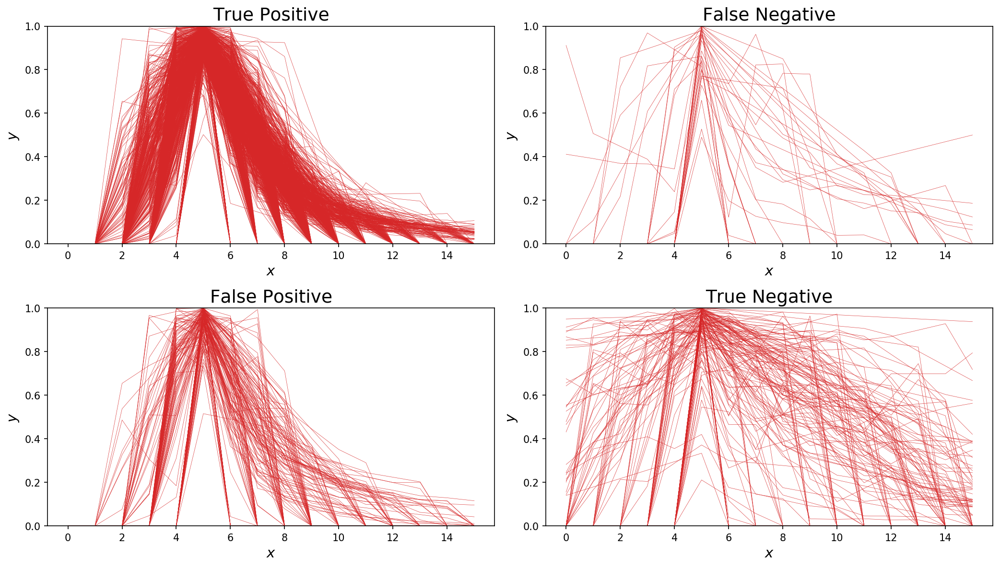

In [75]:
fig, ax = plt.subplots(2, 2, figsize=(14, 8), dpi=150)

#ax_twin_tp = ax[0][0].twinx()
for i in range(TP_data.shape[0]):
    y = TP_data.reset_index().loc[i, 'x_0':'x_15'].values
    #y_d = TP_data.reset_index().loc[i, 'd_0':'d_15'].values
    x = np.arange(len(y))
    #x_d = np.arange(16, 32)
    ax[0][0].plot(x, y, color='C3', linewidth=0.3)
    #ax_twin_tp.plot(x_d, y_d, color='C0', linewidth=0.3)
    ax[0][0].set_ylim(0., 1)
    #ax_twin_tp.set_ylim(0., 5)
    ax[0][0].set_title('True Positive', fontsize=18)
    
#ax_twin_fn = ax[0][1].twinx()
for i in range(FN_data.shape[0]):
    y = FN_data.reset_index().loc[i, 'x_0':'x_15'].values
    #y_d = FN_data.reset_index().loc[i, 'd_0':'d_15'].values
    x = np.arange(len(y))
    #x_d = np.arange(16, 32)
    ax[0][1].plot(x, y, color='C3', linewidth=0.3)
    #ax_twin_fn.plot(x_d, y_d, color='C0', linewidth=0.3)
    ax[0][1].set_ylim(0., 1)
    #ax_twin_fn.set_ylim(0., 5)
    ax[0][1].set_title('False Negative', fontsize=18)
    
#ax_twin_fp = ax[1][0].twinx()
for i in range(FP_data.shape[0]):
    y = FP_data.reset_index().loc[i, 'x_0':'x_15'].values
    #y_d = FP_data.reset_index().loc[i, 'd_0':'d_15'].values
    x = np.arange(len(y))
    #x_d = np.arange(16, 32)
    ax[1][0].plot(x, y, color='C3', linewidth=0.3)
    #ax_twin_fp.plot(x_d, y_d, color='C0', linewidth=0.3)
    ax[1][0].set_ylim(0., 1)
    #ax_twin_fp.set_ylim(0., 5)
    ax[1][0].set_title('False Positive', fontsize=18)
    
#ax_twin_tn = ax[1][1].twinx()
for i in range(TN_data.shape[0]):
    y = TN_data.reset_index().loc[i, 'x_0':'x_15'].values
    #y_d = TN_data.reset_index().loc[i, 'd_0':'d_15'].values
    x = np.arange(len(y))
    #x_d = np.arange(16, 32)
    ax[1][1].plot(x, y, color='C3', linewidth=0.3)
    #ax_twin_tn.plot(x_d, y_d, color='C0', linewidth=0.3)
    ax[1][1].set_ylim(0., 1)
    #ax_twin_tn.set_ylim(0., 5)
    ax[1][1].set_title('True Negative', fontsize=18)
    
    
ax[0][0].set_xlabel('$x$', fontsize=14)
ax[0][0].set_ylabel('$y$', fontsize=14)
ax[0][1].set_xlabel('$x$', fontsize=14)
ax[0][1].set_ylabel('$y$', fontsize=14)
ax[1][0].set_xlabel('$x$', fontsize=14)
ax[1][0].set_ylabel('$y$', fontsize=14)
ax[1][1].set_xlabel('$x$', fontsize=14)
ax[1][1].set_ylabel('$y$', fontsize=14)

plt.tight_layout()
plt.savefig(fname='images/confusion.png', dpi=300, format='png')
plt.show()

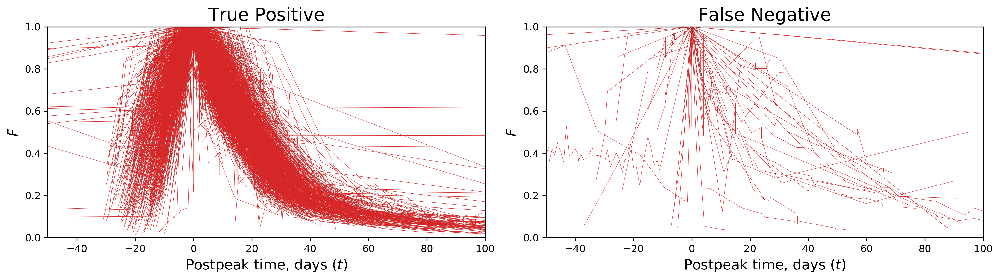

In [76]:
fig, ax = plt.subplots(1, 2, figsize=(14, 4), dpi=300)

for i in range(TP_data.shape[0]):
    y = TP_data.reset_index().loc[i, 'y_normed']
    x = TP_data.reset_index().loc[i, 'x_shifted']
    ax[0].plot(x, y, color='C3', linewidth=0.3)
    ax[0].set_ylim(0., 1)
    ax[0].set_ylabel('$F$', fontsize=14)
    ax[0].set_xlabel('Postpeak time, days $(t)$', fontsize=14)
    ax[0].set_xlim(-50, 100)
    ax[0].set_title('True Positive', fontsize=18)
    
for i in range(FN_data.shape[0]):
    y = FN_data.reset_index().loc[i, 'y_normed']
    x = FN_data.reset_index().loc[i, 'x_shifted']
    ax[1].plot(x, y, color='C3', linewidth=0.3)
    ax[1].set_ylim(0., 1)
    ax[1].set_ylabel('$F$', fontsize=14)
    ax[1].set_xlabel('Postpeak time, days $(t)$', fontsize=14)
    ax[1].set_xlim(-50, 100)
    ax[1].set_title('False Negative', fontsize=18)
    
plt.tight_layout()
plt.savefig(fname='images/init_data_confusion.png', dpi=300, format='png')
plt.show()

### Examination of the peak around 0.1-0.2 x-values of Predicted Class Probability Histogram

In [77]:
cur_df1 = data[(data.rf_pred > 0.1) & (data.rf_pred < 0.2) & (data.type == 'CV')].copy()
cur_df1.type.value_counts()

CV    2
Name: type, dtype: int64

In [78]:
cur_df2 = data[(data.rf_pred >= 0.0) & (data.rf_pred < 0.1)].copy()
cur_df2.type.value_counts()

II                    17
II P;II                6
II P                   5
II;II P                4
SLSN-I                 4
IIn                    3
Ic                     3
CV                     2
SLSN-I;SLSN-I-R;II     1
CV?                    1
SLSN-II                1
SLSN-I;Ic?             1
SLSN-I;Ic;Ic BL        1
YSO                    1
IIn;II                 1
II;IIn                 1
II;IIb                 1
Ia;Ia;Ia               1
SLSN-I;SLSN            1
II;Ia-91T              1
SLSN-I;Ic?;Ia          1
SLSN-R                 1
Name: type, dtype: int64

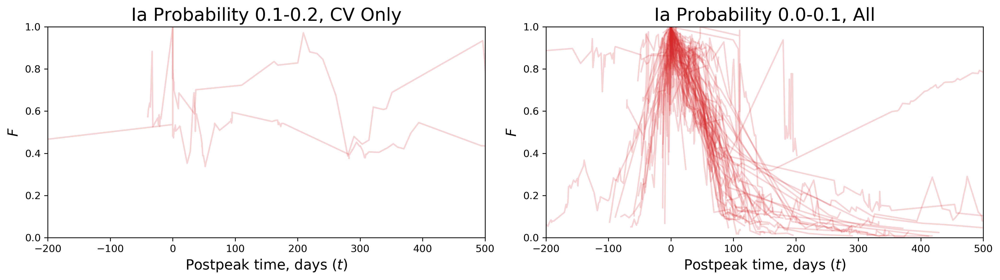

In [79]:
fig, ax = plt.subplots(1, 2, figsize=(14, 4), dpi=300)

for i in range(cur_df1.shape[0]):
    y = cur_df1.reset_index().loc[i, 'y_normed']
    x = cur_df1.reset_index().loc[i, 'x_shifted']
    ax[0].plot(x, y, color='C3', alpha=0.2)
    ax[0].set_ylim(0., 1)
    ax[0].set_ylabel('$F$', fontsize=14)
    ax[0].set_xlabel('Postpeak time, days $(t)$', fontsize=14)
    ax[0].set_xlim(-200, 500)
    ax[0].set_title('Ia Probability 0.1-0.2, CV Only', fontsize=18)
    
for i in range(cur_df2.shape[0]):
    y = cur_df2.reset_index().loc[i, 'y_normed']
    x = cur_df2.reset_index().loc[i, 'x_shifted']
    ax[1].plot(x, y, color='C3', alpha=0.2)
    ax[1].set_ylim(0., 1)
    ax[1].set_ylabel('$F$', fontsize=14)
    ax[1].set_xlabel('Postpeak time, days $(t)$', fontsize=14)
    ax[1].set_xlim(-200, 500)
    ax[1].set_title('Ia Probability 0.0-0.1, All', fontsize=18)
    
plt.tight_layout()
plt.show()